In [1]:
from m6bk import *

In [2]:
dataset_handler = DatasetHandler()

# Environment Perception For Self-Driving Cars


**In this project, I will:**

- Use the output from semantic segmentation neural networks to estimate the 3D drivable space.
- Use the output from semantic segmentation neural networks to estimate traffic lanes.
- Use semantic segmentation results to filter errors in the output of 2D object detectors.
- Use the filtered 2D object detection results to determine the distance of obstacles relative to the autonomous vehicle.

To structure the project, I will follow sequential steps, where each part builds upon the previous one.



In [3]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
from m6bk import *
import sys

%matplotlib inline
%load_ext autoreload
%autoreload 2

np.random.seed(1)
np.set_printoptions(precision=2, threshold=sys.maxsize)

## 0 - Loading and Visualizing the Data

For this project, I will work with simulated data from CARLA, a simulation environment for autonomous vehicles.

I will design a dataset handler structure to read and process these data efficiently : 

In [4]:
dataset_handler = DatasetHandler()


The dataset handler includes three test frames: 0, 1, and 2. Each frame contains:

**DatasetHandler().rgb** : An RGB image captured by the camera.

**DatasetHandler().depth** : A depth image that provides distance information in meters for each pixel.

**DatasetHandler().segmentation**: An image representing the output of a semantic segmentation neural network as pixel-wise category data.

**DatasetHandler().object_detection**: A numpy array containing the output of an object detection neural network. **Frame 0 will serve as the primary example throughout the project, while frames 1 and 2 will be used to validate and test the proposed solutions.** . La frame 2 est fournie comme défi pour les apprenants intéressés par un exemple plus difficile.

The current data frame being read can be identified using the following command : 

In [5]:
dataset_handler.current_frame

0

By default, frame 0 is loaded when the dataset handler is initialized. This frame's content can be accessed through its attributes: **image, depth, object_detection et semantic segmentation**.

For example, I will use code snippets to access the image, camera calibration matrix, and depth information : 

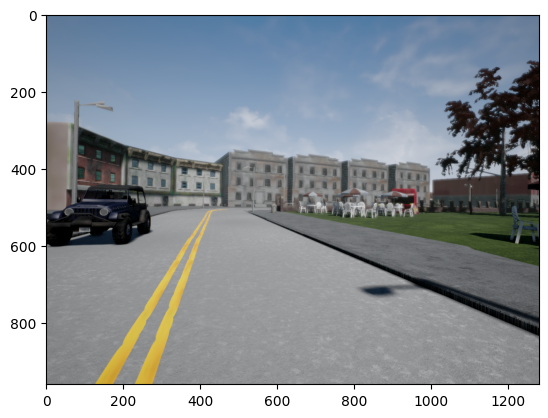

In [6]:
image = dataset_handler.image
plt.imshow(image)

In [7]:
k = dataset_handler.k
print(k)

[[640   0 640]
 [  0 640 480]
 [  0   0   1]]


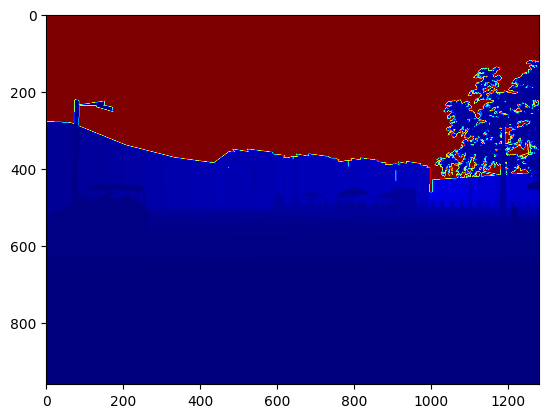

In [8]:
depth = dataset_handler.depth
plt.imshow(depth, cmap='jet')

The output of semantic segmentation can be accessed similarly through:

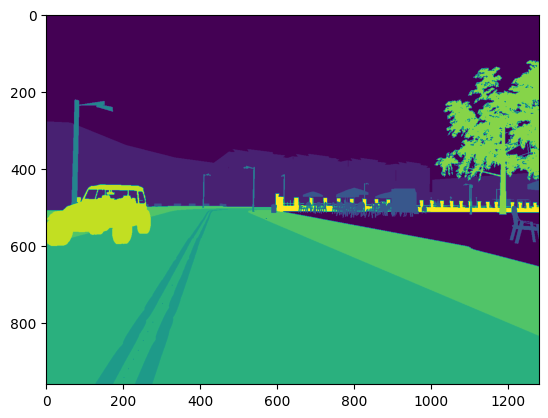

In [9]:
segmentation = dataset_handler.segmentation
plt.imshow(segmentation)

### Mapping Semantic Segmentation Categories:
The output segmentation image maps each pixel to a category corresponding to a road scene element. To visualize this output, I will map indices to different colors. The mapping indices and their corresponding visualization colors are as follows:

|Category|Mapping Index	|Vizualisation color|
| --- | --- | --- |
|Background|	0	| Black |
|Buildings|	1	| Red |
|Pedestrians|	4 |	Teal |
|Poles|	5 |	White |
|Lane Markings|	6 |	Purple |
|Roads|	7 |	Blue |
|Sidewalk|	8 |	Yellow |
|Vehicles|	10| 	Green |




The **vis_segmentation** function of the dataset handler will convert the index image to a color image for visualization.

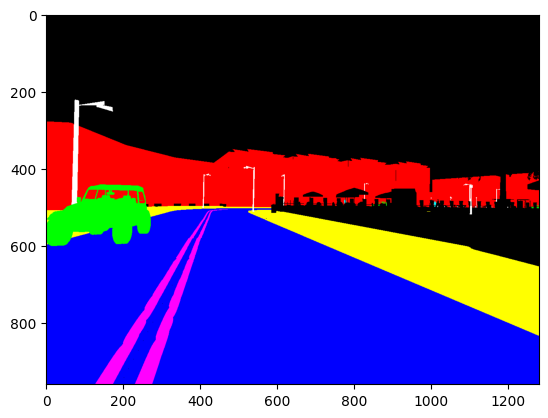

In [10]:
colored_segmentation = dataset_handler.vis_segmentation(segmentation)

plt.imshow(colored_segmentation)

The **set_frame** function will load a specific frame and its associated data, which will be useful for tests and validations later in the project.

In [11]:
dataset_handler.set_frame(2)
dataset_handler.current_frame

2

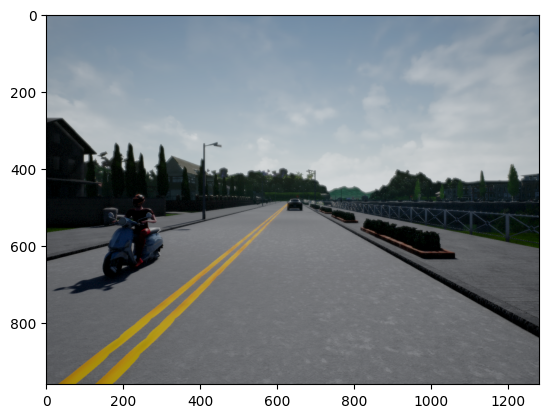

In [12]:
image = dataset_handler.image
plt.imshow(image)

## 1 - Estimating the Drivable Space Using Semantic Segmentation



My first task is to implement the estimation of the 3D drivable space. I have the output of a semantic segmentation neural network, the camera calibration matrix 𝐾, and per-pixel depth information at my disposal.

### 1.1 - Estimating x, y, z Coordinates for Each Pixel in the Image:

To calculate the x,y,z coordinates of each pixel using the camera's calibration matrix and depth information, I will apply the following equations:

$$z = depth $$

$$x = \frac{(u - c_u) * z}{f} \tag{1}$$

$$y = \frac{(v - c_v) * z}{f} \tag{2}$$

Where $c_u$, $c_v$ et $f$ are intrinsic calibration parameters from the camera's calibration matrix 
𝐾.

$$K = \begin{pmatrix} f & 0 & u_c \\ 0 & f & u_v \\ 0& 0 & 1 \end{pmatrix}$$

Let's Implement the estimation of the coordinates x and y of each pixel using the equations (1) and (2) : 


In [13]:
# GRADED FUNCTION: xy_from_depth
# GRADED FUNCTION: xy_from_depth
def xy_from_depth(depth, k):
    """
    Calcule les coordonnées x et y de chaque pixel dans l'image en utilisant la carte de profondeur et la matrice de calibration.

    Arguments :

    depth : tenseur de dimension (H, W), contient une valeur de profondeur (en mètres) pour chaque pixel de l'image.
    k : tenseur de dimension (3x3), la matrice de caméra intrinsèque.
    Renvoie :

    x : tenseur de dimension (H, W) contenant les coordonnées x de chaque pixel dans le repère de la caméra.
    y : tenseur de dimension (H, W) contenant les coordonnées y de chaque pixel dans le repère de la caméra.
    """
    ### START CODE HERE ### (≈ 7 lines in total)

    # Obtenir le shape du tenseur de profondeur
    height, width = depth.shape
    
    # Extraire les paramètres requis de la matrice K
    f_x = k[0, 0]  # Focal length in x
    f_y = k[1, 1]  # Focal length in y
    c_x = k[0, 2]  # Principal point x
    c_y = k[1, 2]  # Principal point y
    
    # Générer une grille de coordonnées correspondant à la forme de la carte de profondeur
    x_indices, y_indices = np.meshgrid(np.arange(width), np.arange(height))
    
    # Calculer les coordonnées x et y
    x = (x_indices - c_x) * depth / f_x
    y = (y_indices - c_y) * depth / f_y


    ### END CODE HERE ###

    return x, y
   
    

In [14]:
x,y = xy_from_depth(depth, k)
print("Valeurs de X:", x)
print("Valeurs de Y:", y)

Valeurs de X: [[-1.00e+03 -9.98e+02 -9.97e+02 -9.95e+02 -9.94e+02 -9.92e+02 -9.91e+02
  -9.89e+02 -9.88e+02 -9.86e+02 -9.84e+02 -9.83e+02 -9.81e+02 -9.80e+02
  -9.78e+02 -9.77e+02 -9.75e+02 -9.73e+02 -9.72e+02 -9.70e+02 -9.69e+02
  -9.67e+02 -9.66e+02 -9.64e+02 -9.62e+02 -9.61e+02 -9.59e+02 -9.58e+02
  -9.56e+02 -9.55e+02 -9.53e+02 -9.52e+02 -9.50e+02 -9.48e+02 -9.47e+02
  -9.45e+02 -9.44e+02 -9.42e+02 -9.41e+02 -9.39e+02 -9.38e+02 -9.36e+02
  -9.34e+02 -9.33e+02 -9.31e+02 -9.30e+02 -9.28e+02 -9.27e+02 -9.25e+02
  -9.23e+02 -9.22e+02 -9.20e+02 -9.19e+02 -9.17e+02 -9.16e+02 -9.14e+02
  -9.12e+02 -9.11e+02 -9.09e+02 -9.08e+02 -9.06e+02 -9.05e+02 -9.03e+02
  -9.02e+02 -9.00e+02 -8.98e+02 -8.97e+02 -8.95e+02 -8.94e+02 -8.92e+02
  -8.91e+02 -8.89e+02 -8.88e+02 -8.86e+02 -8.84e+02 -8.83e+02 -8.81e+02
  -8.80e+02 -8.78e+02 -8.77e+02 -8.75e+02 -8.73e+02 -8.72e+02 -8.70e+02
  -8.69e+02 -8.67e+02 -8.66e+02 -8.64e+02 -8.62e+02 -8.61e+02 -8.59e+02
  -8.58e+02 -8.56e+02 -8.55e+02 -8.53e+02 -8.52e+0

In [15]:
dataset_handler.set_frame(0)

k = dataset_handler.k

z = dataset_handler.depth

x, y = xy_from_depth(z, k)

print('x[800,800] = ' + str(x[800, 800]))
print('y[800,800] = ' + str(y[800, 800]))
print('z[800,800] = ' + str(z[800, 800]) + '\n')

print('x[500,500] = ' + str(x[500, 500]))
print('y[500,500] = ' + str(y[500, 500]))
print('z[500,500] = ' + str(z[500, 500]) + '\n')

x[800,800] = 0.716
y[800,800] = 1.432
z[800,800] = 2.864

x[500,500] = -9.64315625
y[500,500] = 1.37759375
z[500,500] = 44.083



**Expected Output**:

$x[800,800] = 0.720$
<br />
$y[800,800] = 1.436$
<br />
$z[800,800] = 2.864$

$x[500,500] = -9.5742765625$
<br />
$y[500,500] = 1.4464734375$
<br />
$z[500,500] = 44.083$

### 1.2 - Estimating the Ground Plane Using RANSAC:

In the context of autonomous vehicles, drivable space includes all areas the vehicle can physically traverse in 3D. I will use the RANSAC algorithm to estimate the ground plane from the x,y,z coordinates.

The first step is to process the semantic segmentation output to extract the relevant pixels belonging to the class you want to consider as the ground. For this evaluation, this class is the road class with a mapping index of 7. To extract the x, y, and z coordinates of the road, execute the following cell:

Original data points: (3, 411193)


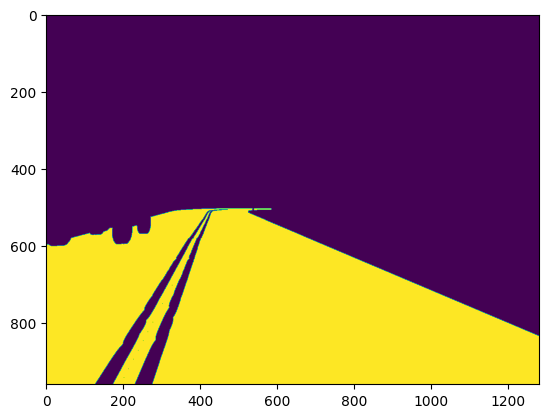

In [16]:
# Get road mask by choosing pixels in segmentation output with value 7
road_mask = np.zeros(segmentation.shape)
road_mask[segmentation == 7] = 1

# Show road mask
plt.imshow(road_mask)

# Get x,y, and z coordinates of pixels in road mask
x_ground = x[road_mask == 1]
y_ground = y[road_mask == 1]
z_ground = dataset_handler.depth[road_mask == 1]
xyz_ground = np.stack((x_ground, y_ground, z_ground))
print("Original data points:", xyz_ground.shape)

The next step is to use the extracted x, y, and z coordinates of pixels belonging to the road to estimate the ground plane. RANSAC will be used for robustness against outliers.

Steps for RANSAC:
 - Randomly select a minimum of three points in xyz_ground.
 - Calculate a ground plane model using these points with the provided compute_plane function.
 - Measure the distance of all points from the estimated plane and count the inliers within a threshold distance.
 - Retain the model with the highest number of inliers.
 - Repeat until a predefined number of iterations or inlier count is reached.
 - Recalculate and return a final plane model using all inliers.






Useful Functions :  `np.random.choice()`, `compute_plane()`, `dist_to_plane()`.

The following two custom functions are provided to help you complete this section:

1. ***compute_plane(xyz):***
```
    Computes the coefficients of the plane a, b, c, d in the form ax+by+cz+d = 0.

    Arguments:
    xyz -- tensor of dimension (3, N), containing the points needed to fit the plane.
    k -- tensor of dimension (3x3), the intrinsic camera matrix.

    Returns:
    p -- tensor of dimension (1, 4) containing the plane parameters a, b, c, d.

```

2. ***dist_to_plane(plane, x, y, z):***

```
    Computes the distance of N points to a plane in 3D, given the plane parameters and the x, y, z coordinates of the points.

    Arguments:
    plane -- tensor of dimension (4, 1), containing the plane parameters [a, b, c, d].
    x -- tensor of dimension (N, 1), containing the x-coordinates of the points.
    y -- tensor of dimension (N, 1), containing the y-coordinates of the points.
    z -- tensor of dimension (N, 1), containing the z-coordinates of the points.

    Returns:
    distance -- tensor of dimension (N, 1) containing the distances between the points and the plane.


```
The functions are already loaded thanks to the import statement at the beginning of the notebook. You can also implement the plane estimation yourself if you are ready to take on the challenge!

In [54]:


def grid_subsampling(xyz, grid_size):
    """
    Reduces the number of points by grouping them into a regular grid.

    Parameters:
    xyz (np.ndarray): 3xN array containing the 3D points (x, y, z coordinates).
    grid_size (float): The size of each grid cell.

    Returns:
    np.ndarray: 3xM array of points after subsampling.
    """
    # Calculate grid indices
    min_xyz = np.min(xyz, axis=1, keepdims=True)
    indices = np.floor((xyz - min_xyz) / grid_size).astype(int)
    
    # Create unique keys for each grid cell
    keys = indices[0, :] + indices[1, :] * 10007 + indices[2, :] * 1000003  # Large primes to minimize collisions
    
    # Use unique keys to find the first occurrence (representative point) for each cell
    _, unique_indices = np.unique(keys, return_index=True)
    
    # Select the points that correspond to these indices
    return xyz[:, unique_indices]




In [17]:


def ransac_plane_fit(xyz_ground, num_iterations=1000, min_inliers=100, distance_threshold=0.01):
    """
    Perform RANSAC algorithm to fit a plane in a 3D point cloud data.
    """
    best_plane = None
    max_inliers_count = 0
    best_three_points = np.zeros((3, 3))  # Will store the best three points found

    for _ in range(num_iterations):
        # Step 1: Randomly select a minimum of 3 points
        indices = np.random.choice(xyz_ground.shape[1], 3, replace=False)
        sample_points = xyz_ground[:, indices]

        # Step 2: Calculate the plane model
        plane = compute_plane(sample_points)

        # Step 3: Measure distance to the plane for all points
        distances = dist_to_plane(plane, xyz_ground[0, :], xyz_ground[1, :], xyz_ground[2, :])

        # Step 4: Count inliers
        inliers = distances <= distance_threshold
        num_inliers = np.sum(inliers)

        # Check if the current set of inliers is the largest we have found so far
        if num_inliers > max_inliers_count:
            max_inliers_count = num_inliers
            best_plane = plane
            best_three_points = sample_points  # Store the sample points used to compute the best plane

        # Step 5: Check for stopping criteria
        if num_inliers >= min_inliers:
            break

    # Step 6: Recalculate the plane model using the best three points found
    best_plane = compute_plane(best_three_points)

    return best_plane


In [18]:



# Run RANSAC with subsampled data
p_final = ransac_plane_fit(xyz_ground)
print('Ground Plane:', p_final)


Ground Plane: [ 0.02 -1.    0.01  1.4 ]


**Expected Output**:

Ground Plane: [0.01791606 -0.99981332  0.00723433  1.40281479]

To verify if the estimated plane is correct, we can visualize the set of inliers computed across the entire image. Use the cell below to calculate and visualize the ground mask in the 2D image space.

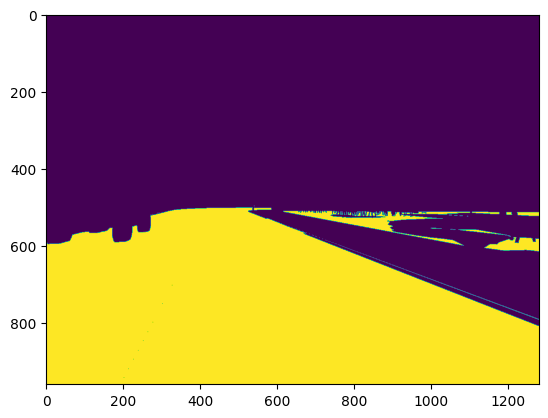

In [19]:
dist = np.abs(dist_to_plane(p_final, x, y, z))

ground_mask = np.zeros(dist.shape)

ground_mask[dist < 0.1] = 1
ground_mask[dist > 0.1] = 0

plt.imshow(ground_mask)

We also provide a function to visualize the estimated driving space in 3D. Run the following cell to visualize your estimated 3D driving space.

c:\Users\pret\Desktop\TP Vehicule autonome\m6bk.py:226: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(labels)
c:\Users\pret\Desktop\TP Vehicule autonome\m6bk.py:230: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels)


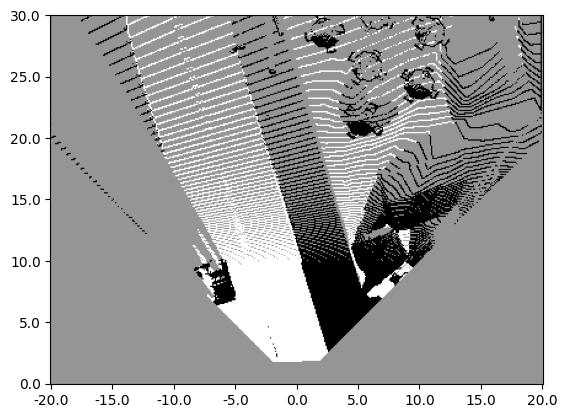

In [20]:
dataset_handler.plot_free_space(ground_mask)

The visualization above shows only where the autonomous car can physically move. Obstacles, such as the SUV on the left side of the image, appear as dark pixels in our visualization.

<tr>
<td> <img src="images/image.png" style="width:320px;height:240px;">   </td>
<td> <img src="images/occ_grid.png" style="width:240px;height:240px;">   </td>
</tr>

However, estimating the driving space is not sufficient for the autonomous car to navigate the roads. The car must also perform lane estimation to determine where it is legally allowed to drive. 

## 2 - Estimating Lanes Using Semantic Segmentation


We will now use the output of semantic segmentation to estimate the lane boundaries of the current lane used by the autonomous car.
This task can be divided into two subtasks: lane line estimation and post-processing through filtering horizontal lines and merging similar lines.

### 2.1 Estimating Lane Boundary Proposals:

I will extract lane boundaries by identifying pixels corresponding to "lane markings" and "sidewalks." These pixels will be processed using contour detection and line estimation techniques, such as the Hough Transform.

Useful functions: `cv2.Canny()`, `cv2.HoughLinesP()`, `np.squeeze()`.

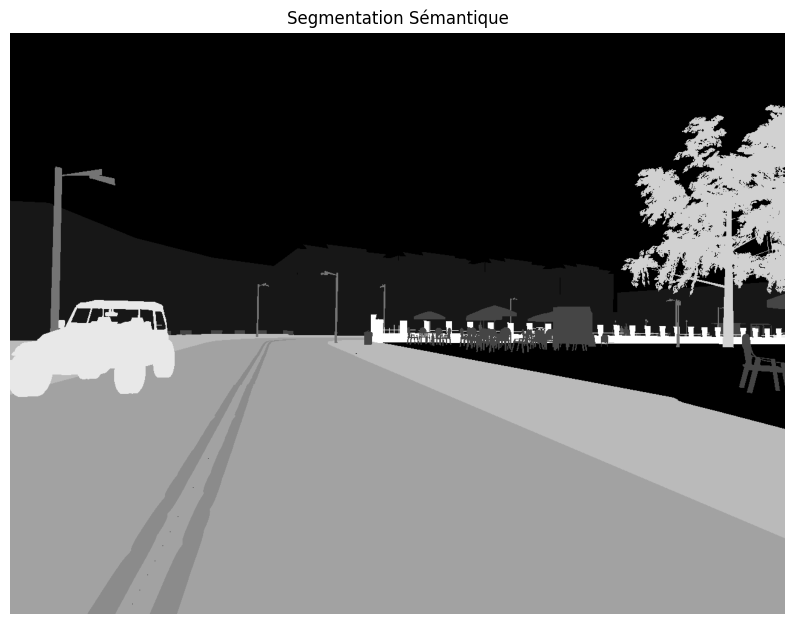

In [21]:
import matplotlib.pyplot as plt

def display_segmentation_image(segmentation_output):
    """
    Affiche l'image de segmentation sémantique.

    Arguments:
    segmentation_output -- tenseur de dimension (H, W), contenant la sortie du réseau neuronal de segmentation sémantique
    """
    plt.figure(figsize=(10, 10))
    plt.imshow(segmentation_output, cmap='gray')
    plt.title('Segmentation Sémantique')
    plt.axis('off')
    plt.show()

# Exemple d'utilisation
# segmentation_output = ...  # Charger ou définir la sortie de segmentation

display_segmentation_image(segmentation)


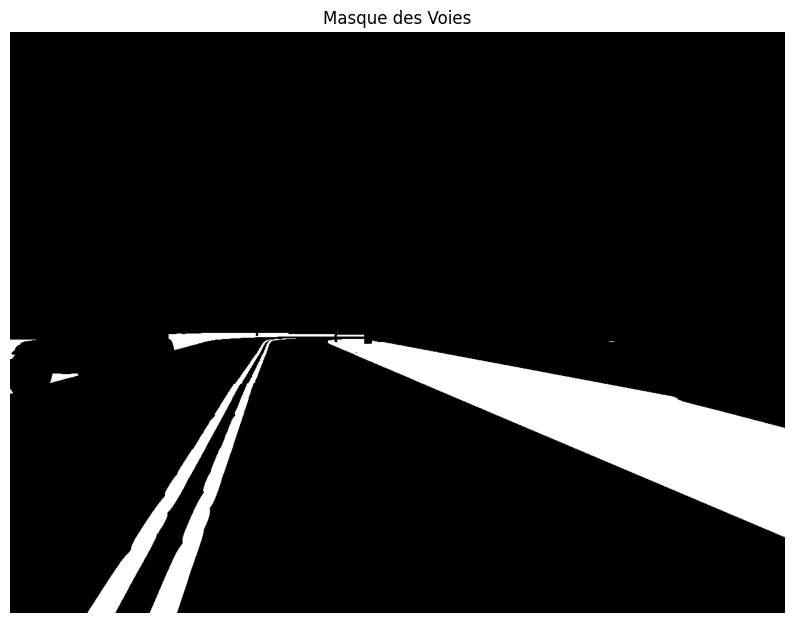

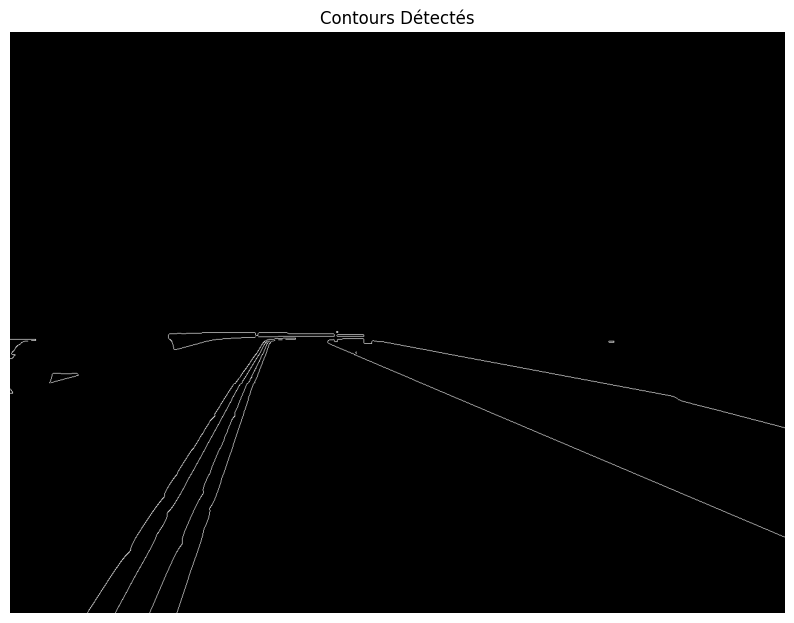

In [24]:

import cv2
import matplotlib.pyplot as plt

def estimate_lane_lines(segmentation_output, minLineLength=10, maxLineGap=10):
    """
    Estime les lignes appartenant aux limites des voies. Plusieurs lignes peuvent correspondre à une seule voie.

    Arguments:
    segmentation_output -- tenseur de dimension (H, W), contenant la sortie du réseau neuronal de segmentation sémantique
    minLineLength -- scalaire, la longueur minimale de ligne
    maxLineGap -- scalaire, l'écart maximal entre les lignes

    Renvoie:
    lines -- tenseur de dimension (N, 4) contenant les lignes sous la forme [x_1, y_1, x_2, y_2], où [x_1, y_1] et [x_2, y_2] sont
    les coordonnées de deux points sur la ligne dans le système de coordonnées d'image (u,v).
    """
    # Étape 1: Créez une image avec les pixels appartenant aux catégories de limites de voie à partir de la sortie de la segmentation sémantique
    road_mask = np.isin(segmentation_output, [6, 8]).astype(np.uint8) * 255

    # Afficher le masque des voies pour vérifier visuellement
    plt.figure(figsize=(10, 10))
    plt.imshow(road_mask, cmap='gray')
    plt.title('Masque des Voies')
    plt.axis('off')
    plt.show()

    # Étape 2: Effectuez une détection de contour en utilisant cv2.Canny()
    edges = cv2.Canny(road_mask, 50, 150)  # Ajustez les seuils si nécessaire

    # Afficher les contours détectés pour vérification
    plt.figure(figsize=(10, 10))
    plt.imshow(edges, cmap='gray')
    plt.title('Contours Détectés')
    plt.axis('off')
    plt.show()

    # Étape 3: Estimez les lignes en utilisant cv2.HoughLinesP()
    lines = cv2.HoughLinesP(edges, rho=1, theta=np.pi/180, threshold=50, minLineLength=minLineLength, maxLineGap=maxLineGap)

    # S'assurer que les dimensions des lignes renvoyées sont (N x 4)
    if lines is not None:
        lines = lines.reshape(-1, 4)
    else:
        lines = np.empty((0, 4))

    return lines



# Exécutez la fonction estimate_lane_lines
lane_lines = estimate_lane_lines(segmentation)

# Affichez les lignes détectées sur l'image d'origine pour vérification
def display_detected_lines(image, lines):
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    for line in lines:
        x1, y1, x2, y2 = line
        plt.plot([x1, x2], [y1, y2], 'm', linewidth=2)
    plt.title('Lignes Détectées')
    plt.axis('off')
    plt.show()




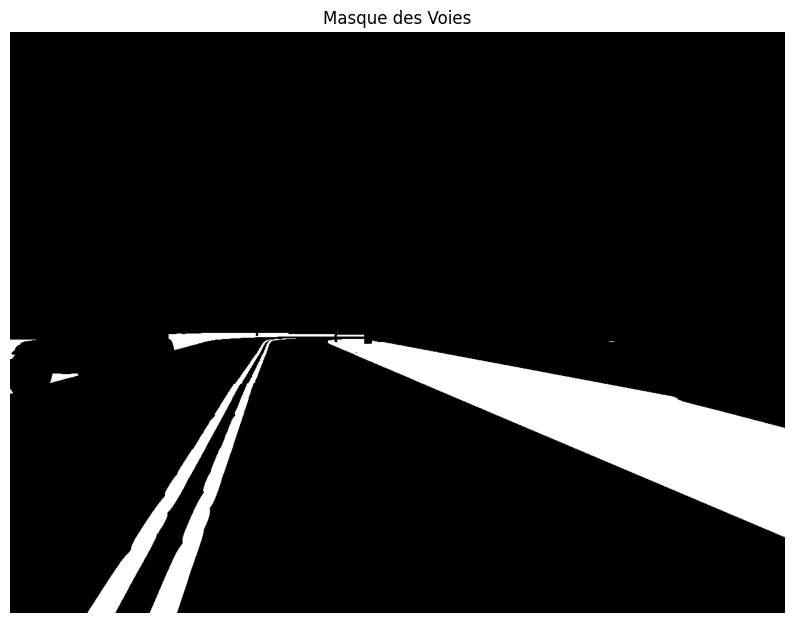

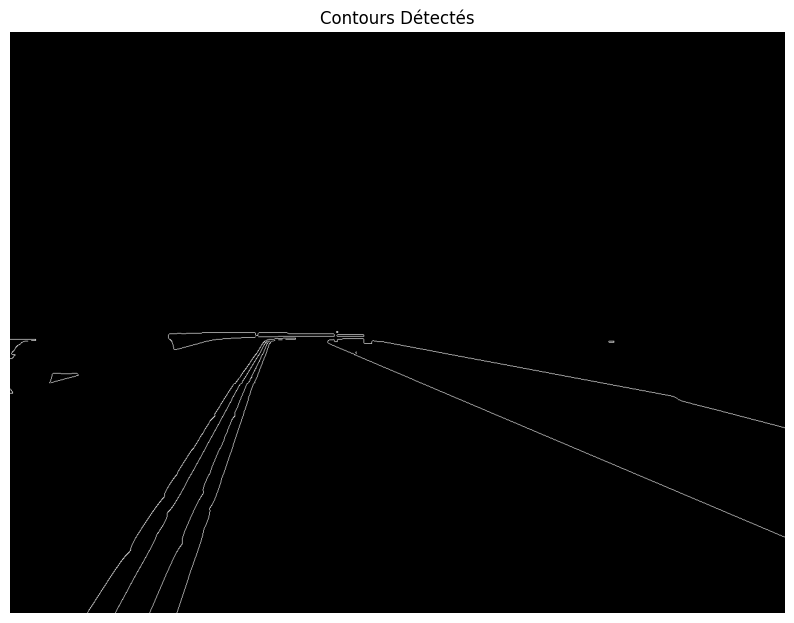

(40, 4)


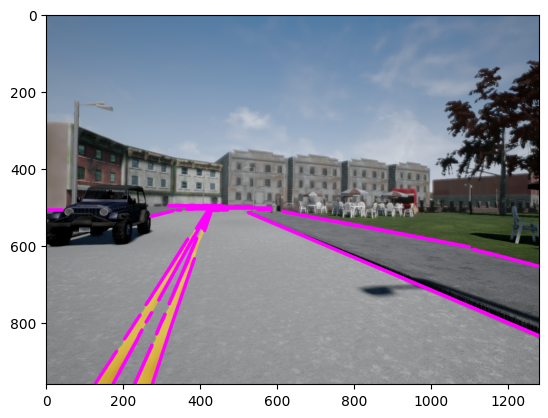

In [25]:
lane_lines = estimate_lane_lines(segmentation)

print(lane_lines.shape)

plt.imshow(dataset_handler.vis_lanes(lane_lines))

***Expected Output***

<img src="images/lanes_1.png" style="width:320px;height:240px;">

### 2.2 - Merging and Filtering Lane Lines:

The detected lines will be analyzed to:

 - Remove irrelevant horizontal lines.
 - Merge similar lines using clustering techniques based on slope and intercept.



In order to do that , I will post-process the output of the estimate_lane_lines function to merge similar lines and filter horizontal lines using their slope and y-intercept. The three steps are as follows:

Obtain the slope and y-intercept of each line using the provided function.
Identify lines with a slope below the horizontal slope threshold. Filtering can be performed later if necessary.
Group the lines into clusters based on their slope and y-intercept.
Merge all the lines in the clusters by calculating their average.








Usefull Functions:
1. ***get_slope_intecept(lines):***

```
  Calculate the distance between N points and a plane in 3D, given the plane parameters and the x,y,z coordinates of the points.

  Arguments : 
  lines -- Tensor of dimension (N,4) containing lines in the form [x_1, y_1, x_2, y_2], which are the coordinates of two points on the line.

  Returns:
  slopes -- Tensor of dimension (N,1) containing the slopes of the lines.
  intercepts -- Tensor of dimension (N,1) containing the y-intercepts of the lines.

```


In [ ]:
# Graded Function: merge_lane_lines
def merge_lane_lines(lines):
    """
    Fusionne les lignes de voie pour produire une seule ligne par voie, en utilisant la pente et l'ordonnée à l'origine comme mesures de similarité.
    Filtre également les lignes de voie horizontales en fonction d'un seuil de pente minimum.

    Arguments :
    lines -- tenseur de dimension (N, 4) contenant des lignes sous la forme [x_1, y_1, x_2, y_2],
    les coordonnées de deux points sur la ligne.

    Renvoie :
    merged_lines -- tenseur de dimension (N, 4) contenant des lignes sous la forme [x_1, y_1, x_2, y_2],
    les coordonnées de deux points sur la ligne.
    """

   

    # Step 0: Define thresholds
    slope_similarity_threshold = 0.1
    intercept_similarity_threshold = 40
    min_slope_threshold = 0.3

    # Step 1: Get slope and intercept of lines
    slopes, intercepts = get_slope_intecept(lines)

    # Step 2: Filter out lines with slope less than horizontal slope threshold
    valid_lines_mask = np.abs(slopes) >= min_slope_threshold
    slopes = slopes[valid_lines_mask]
    intercepts = intercepts[valid_lines_mask]
    lines = lines[valid_lines_mask]

    # Step 3: Cluster lines by similar slope and intercept
    clusters = []
    for slope, intercept, line in zip(slopes, intercepts, lines):
        found_cluster = False
        for cluster in clusters:
            cluster_slope, cluster_intercept, cluster_lines = cluster
            if (abs(slope - cluster_slope) < slope_similarity_threshold and
                abs(intercept - cluster_intercept) < intercept_similarity_threshold):
                cluster_lines.append(line)
                cluster[0] = (cluster_slope * len(cluster_lines) + slope) / (len(cluster_lines) + 1)
                cluster[1] = (cluster_intercept * len(cluster_lines) + intercept) / (len(cluster_lines) + 1)
                found_cluster = True
                break
        if not found_cluster:
            clusters.append([slope, intercept, [line]])

    # Step 4: Merge all lines in clusters using mean averaging
    merged_lines = []
    for cluster in clusters:
        _, _, cluster_lines = cluster
        if len(cluster_lines) > 0:
            cluster_lines = np.array(cluster_lines)
            x1_avg = np.mean(cluster_lines[:, 0])
            y1_avg = np.mean(cluster_lines[:, 1])
            x2_avg = np.mean(cluster_lines[:, 2])
            y2_avg = np.mean(cluster_lines[:, 3])
            merged_lines.append([x1_avg, y1_avg, x2_avg, y2_avg])

    merged_lines = np.array(merged_lines)

    ### END CODE HERE ###
    return merged_lines




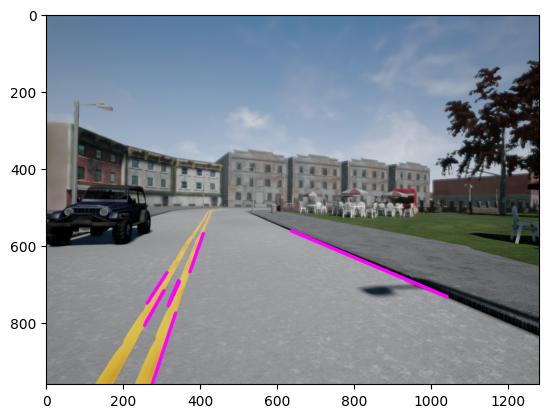

In [27]:
merged_lane_lines = merge_lane_lines(lane_lines)

plt.imshow(dataset_handler.vis_lanes(merged_lane_lines))

***Expected Output***

<img src="images/lanes_2.png" style="width:320px;height:240px;">

You should now have one line per lane as output! The final step is to extrapolate the lanes so that they start at the beginning of the road and end at the end of the road, and to determine the lane markings that belong to the current lane. We provide functions to perform these tasks in the cell below. Execute the cell to visualize the final lane boundaries!

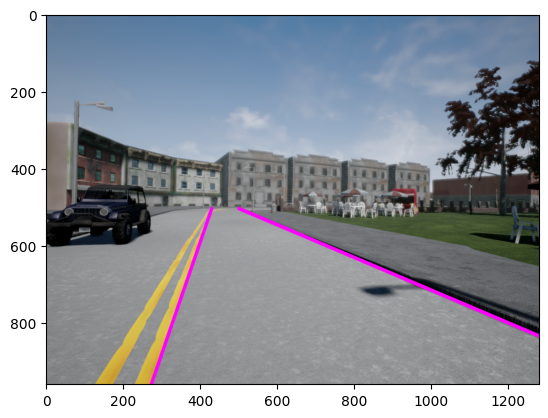

In [28]:
max_y = dataset_handler.image.shape[0]
min_y = np.min(np.argwhere(road_mask == 1)[:, 0])

extrapolated_lanes = extrapolate_lines(merged_lane_lines, max_y, min_y)
final_lanes = find_closest_lines(extrapolated_lanes, dataset_handler.lane_midpoint)
plt.imshow(dataset_handler.vis_lanes(final_lanes))

## 3 - Calculating Minimum Impact Distance Using 2D Object Detection Outputs

We will now use the output of 2D object detection to determine the minimum impact distance to the objects present in the scene.
However, this task is complicated by the fact that the 2D detections come from an object detector with high recall but low precision.
We will first use semantic segmentation to eliminate unreliable detections and then calculate the minimum impact distance.

 Let’s start with a visualization of the detection output for our current image. For visualization, you will use the provided data handling function vis_object_detection as follows:

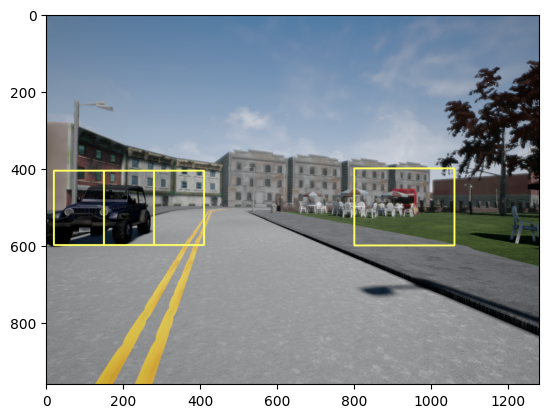

In [29]:
detections = dataset_handler.object_detection

plt.imshow(dataset_handler.vis_object_detection(detections))

The detections are in the format  **[catégorie, x_min, y_min, x_max, y_max, score]**. The category is a string indicating the classification of the bounding box, such as 'Car', 'Pedestrian', or 'Cyclist'. The coordinates **[x_min, y_min]** represent the top-left corner, and **[x_max, y_max]** represent the bottom-right corner of the objects. The score represents the softmax output of the neural network.

In [29]:
print(detections)

[['Car' '20.0' '406.0' '280.0' '599.0' '0.99']
 ['Car' '150.0' '406.0' '410.0' '599.0' '0.95']
 ['Car' '800.0' '400.0' '1060.0' '600.0' '0.76']]


### 3.1 - Filtering Unreliable Detections:

The first thing you may notice is an incorrect detection on the right side of the image. Interestingly, this incorrect detection has a high output score of 0.76 for being a car. Additionally, two bounding boxes are assigned to the vehicle on the left side of the image, both with very high scores above 0.9.

This behavior is expected from an object detector with high precision and low recall. To address this issue, the output of the semantic segmentation network must be used to eliminate unreliable detections.

By cross-referencing object detection outputs with semantic segmentation, I will filter out erroneous detections.

Usefull functions: ``np.asfarray()``



In [30]:


def filter_detections_by_segmentation(detections, segmentation_output):
    """
    Filtre la sortie de détection 2D en fonction d'une carte de segmentation sémantique.

    Arguments :
    detections : tenseur de dimension (N, 6) contenant les détections sous la forme [Classe, x_min, y_min, x_max, y_max, score].
    segmentation_output : tenseur de dimension (H, W) contenant les étiquettes de catégorie de pixels.

    Renvoie :
    filtered_detections : tenseur de dimension (N, 6) contenant les détections sous la forme [Classe, x_min, y_min, x_max, y_max, score].
    """
    # Set ratio threshold:
    ratio_threshold = 0.3  # If 1/3 of the total pixels belong to the target category, the detection is correct.

    # Map of class names to segmentation labels
    class_to_label = {
        'Car': 10,
        'Pedestrian': 4
    }

    # List to store filtered detections
    filtered_detections = []

    for detection in detections:
        cls, x_min, y_min, x_max, y_max, score = detection

        # Convert coordinates to integers
        x_min = int(float(x_min))
        y_min = int(float(y_min))
        x_max = int(float(x_max))
        y_max = int(float(y_max))

        # Ensure coordinates are within the image boundaries
        x_min = max(0, x_min)
        y_min = max(0, y_min)
        x_max = min(segmentation_output.shape[1], x_max)
        y_max = min(segmentation_output.shape[0], y_max)

        # Debugging print statements
        print(f"Processing detection: {cls}, BB: ({x_min}, {y_min}, {x_max}, {y_max}), score: {score}")

        # Calculate the number of pixels belonging to the category for each detection.
        bb_pixels = segmentation_output[y_min:y_max, x_min:x_max]
        
        print(f"bb_pixels shape: {bb_pixels.shape}")
        print("bb_pixels values:", np.unique(bb_pixels))

        # Get the class id from the detection
        cls_id = class_to_label.get(cls)
        print("cls_id is : ", cls_id)
        
        if cls_id is None:
            print(f"Class {cls} not found in class_to_label mapping. Skipping detection.")
            continue

        # Count the number of pixels in the bounding box that belong to the predicted category
        category_pixels_count = np.sum(bb_pixels == cls_id)
        print(f"Category pixels count for {cls}: {category_pixels_count}")

        # Calculate the area of the bounding box
        bb_area = (y_max - y_min) * (x_max - x_min)
        print(f"Bounding box area: {bb_area}")

        # Calculate the ratio of category pixels to the total pixels in the bounding box
        ratio = category_pixels_count / bb_area
        print(f"Ratio of category pixels: {ratio}")

        # If the ratio is above the threshold, keep the detection
        if ratio >= ratio_threshold:
            filtered_detections.append(detection)

    return np.array(filtered_detections)




[['Car' '20.0' '406.0' '280.0' '599.0' '0.99']
 ['Car' '150.0' '406.0' '410.0' '599.0' '0.95']
 ['Car' '800.0' '400.0' '1060.0' '600.0' '0.76']]
Processing detection: Car, BB: (20, 406, 280, 599), score: 0.99
bb_pixels shape: (193, 260)
bb_pixels values: [ 1.  3.  5.  7.  8. 10.]
cls_id is :  10
Category pixels count for Car: 25419
Bounding box area: 50180
Ratio of category pixels: 0.5065563969709047
Processing detection: Car, BB: (150, 406, 410, 599), score: 0.95
bb_pixels shape: (193, 260)
bb_pixels values: [ 1.  3.  5.  6.  7.  8. 10.]
cls_id is :  10
Category pixels count for Car: 13222
Bounding box area: 50180
Ratio of category pixels: 0.2634914308489438
Processing detection: Car, BB: (800, 400, 1060, 600), score: 0.76
bb_pixels shape: (200, 260)
bb_pixels values: [ 0.  1.  3.  4.  5.  8.  9. 10. 11.]
cls_id is :  10
Category pixels count for Car: 80
Bounding box area: 52000
Ratio of category pixels: 0.0015384615384615385


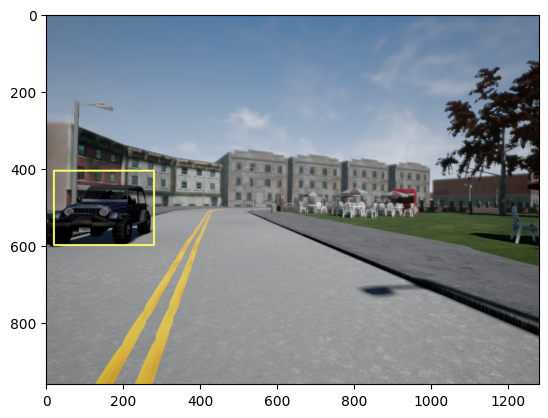

In [31]:
print(detections)
filtered_detections = filter_detections_by_segmentation(detections, segmentation)

plt.imshow(dataset_handler.vis_object_detection(filtered_detections))

### 3.2 - Estimating Minimum Impact Distance:

For each detected object, I will calculate the minimum distance to the camera. This is achieved by finding the smallest distance of all pixels within the bounding box to the camera center.

We will proceed as follows :

1. Calculate the distance to the camera center using the x, y, and z arrays from Part I. This can be done using the equation: $ distance = \sqrt{x^2 + y^2 + z^2}$.
2. Find the minimum distance value among all the pixels inside the bounding box.



In [32]:


def find_min_distance_to_detection(detections, x, y, z):
    """
    Calcule la distance minimale d'impact entre chaque objet détecté et la voiture autonome.

    Arguments :
    detections : tableau numpy de dimension (N, 6) contenant les détections sous la forme [Classe, x_min, y_min, x_max, y_max, score].
    x : tableau numpy de dimension (H, W) contenant les coordonnées x de chaque pixel dans le cadre de référence de la caméra.
    y : tableau numpy de dimension (H, W) contenant les coordonnées y de chaque pixel dans le cadre de référence de la caméra.
    z : tableau numpy de dimension (H, W) contenant les coordonnées z de chaque pixel dans le cadre de référence de la caméra.

    Renvoie :
    min_distances : tableau numpy de dimension (N,) contenant la distance minimale d'impact avec chaque objet dans la scène.
    """
    # Step 1: Compute distance of every pixel in the image
    distances = np.sqrt(x**2 + y**2 + z**2)
    
    min_distances = []
    
    for detection in detections:
        class_name, x_min, y_min, x_max, y_max, score = detection
        x_min, y_min, x_max, y_max = int(float(x_min)), int(float(y_min)), int(float(x_max)), int(float(y_max))
        
        # Step 2: Extract the distances within the bounding box
        bb_distances = distances[y_min:y_max, x_min:x_max]
        
        # Step 3: Find the minimum distance within the bounding box
        min_distance = np.min(bb_distances)
        
        min_distances.append(min_distance)
    
    return np.array(min_distances)






In [33]:

z = dataset_handler.depth

x, y = xy_from_depth(z, k)

min_distances = find_min_distance_to_detection(filtered_detections, x, y, z)

print('Minimum distance to impact is: ' + str(min_distances))


Minimum distance to impact is: [8.52]


**Expected Output**

Minimum distance to impact is: 8.51




Run the cell below to visualize your estimated distance along with the 2D detection output.

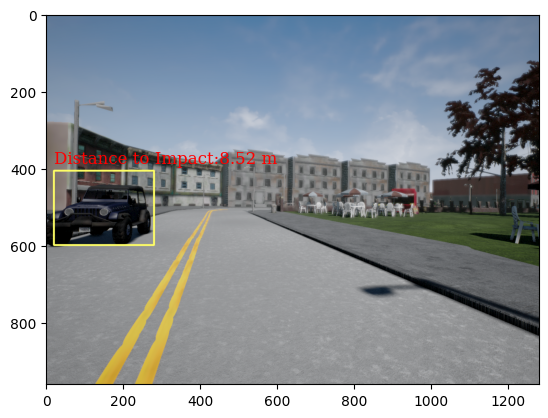

In [34]:
font = {'family': 'serif','color': 'red','weight': 'normal','size': 12}

im_out = dataset_handler.vis_object_detection(filtered_detections)

for detection, min_distance in zip(filtered_detections, min_distances):
    bounding_box = np.asfarray(detection[1:5])
    plt.text(bounding_box[0], bounding_box[1] - 20, 'Distance to Impact:' + str(np.round(min_distance, 2)) + ' m', fontdict=font)

plt.imshow(im_out)

## 4 - Submission:
The results will include:

1. A visualization of the estimated 3D drivable space.
2. Processed lane boundaries.
3. Calculated distances of obstacles from the vehicle.

I will ensure all steps are properly documented and visualized to validate the performance of the developed solutions.


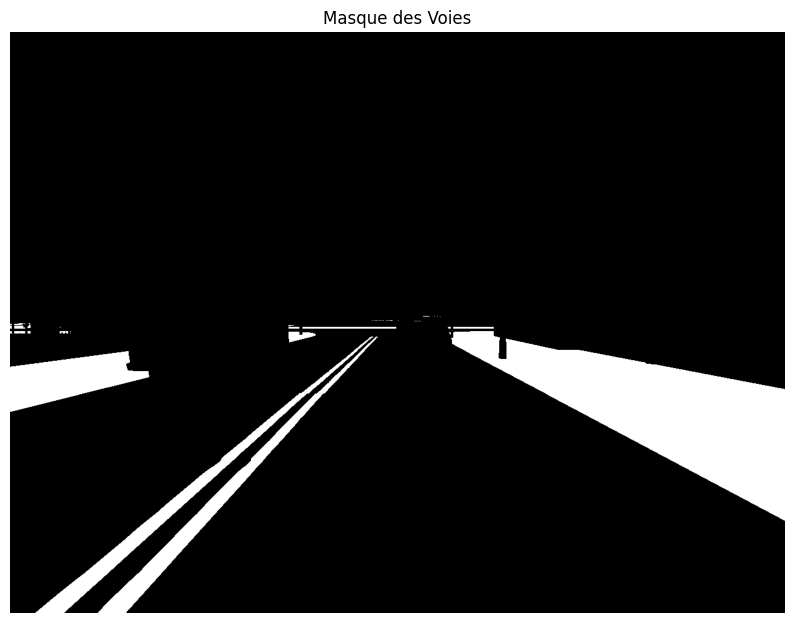

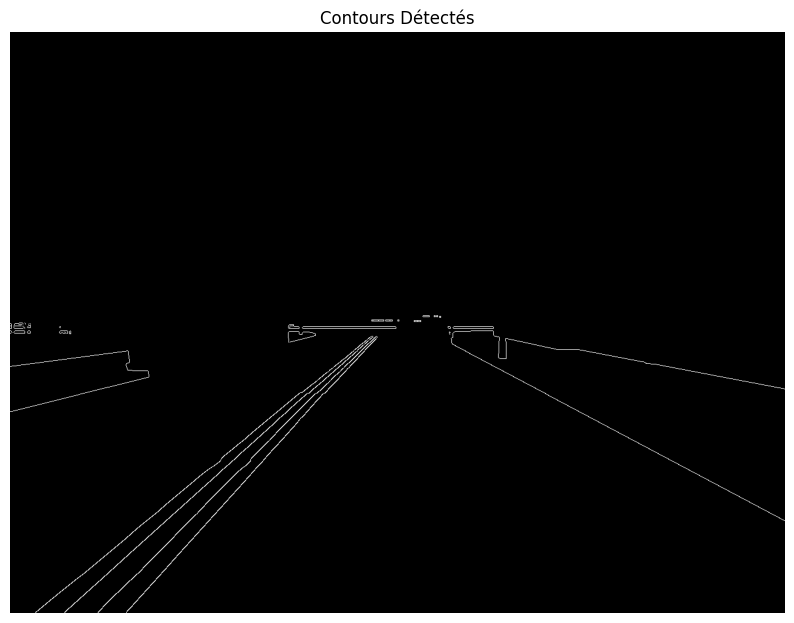

Processing detection: Pedestrian, BB: (900, 350, 1000, 600), score: 0.74
bb_pixels shape: (250, 100)
bb_pixels values: [0. 1. 8.]
cls_id is :  4
Category pixels count for Pedestrian: 0
Bounding box area: 25000
Ratio of category pixels: 0.0
Processing detection: Car, BB: (180, 390, 470, 600), score: 0.68
bb_pixels shape: (210, 290)
bb_pixels values: [ 0.  1.  3.  4.  5.  7.  8.  9. 10. 11. 12.]
cls_id is :  10
Category pixels count for Car: 33494
Bounding box area: 60900
Ratio of category pixels: 0.5499835796387521
Processing detection: Car, BB: (620, 438, 760, 558), score: 0.98
bb_pixels shape: (120, 140)
bb_pixels values: [ 0.  1.  2.  3.  5.  7.  8.  9. 10. 12.]
cls_id is :  10
Category pixels count for Car: 6057
Bounding box area: 16800
Ratio of category pixels: 0.3605357142857143
Processing detection: Car, BB: (650, 476, 795, 596), score: 0.98
bb_pixels shape: (120, 145)
bb_pixels values: [ 0.  1.  2.  3.  5.  7.  8.  9. 10.]
cls_id is :  10
Category pixels count for Car: 4303
Boun

In [35]:
dataset_handler = DatasetHandler()
dataset_handler.set_frame(1)
segmentation = dataset_handler.segmentation
detections = dataset_handler.object_detection
z = dataset_handler.depth

# Part 1
k = dataset_handler.k
x, y = xy_from_depth(z, k)
road_mask = np.zeros(segmentation.shape)
road_mask[segmentation == 7] = 1
x_ground = x[road_mask == 1]
y_ground = y[road_mask == 1]
z_ground = dataset_handler.depth[road_mask == 1]
xyz_ground = np.stack((x_ground, y_ground, z_ground))
p_final = ransac_plane_fit(xyz_ground)

# Part II
lane_lines = estimate_lane_lines(segmentation)
merged_lane_lines = merge_lane_lines(lane_lines)
max_y = dataset_handler.image.shape[0]
min_y = np.min(np.argwhere(road_mask == 1)[:, 0])

extrapolated_lanes = extrapolate_lines(merged_lane_lines, max_y, min_y)
final_lanes = find_closest_lines(extrapolated_lanes, dataset_handler.lane_midpoint)

# Part III
filtered_detections = filter_detections_by_segmentation(detections, segmentation)
min_distances = find_min_distance_to_detection(filtered_detections, x, y, z)

# Print Submission Info

final_lane_printed = [list(np.round(lane)) for lane in final_lanes]
print('plane:')
print(list(np.round(p_final, 2)))
print('\n lanes:')
print(final_lane_printed)
print('\n min_distance')
print(list(np.round(min_distances, 2)))


### Visualize your Results:



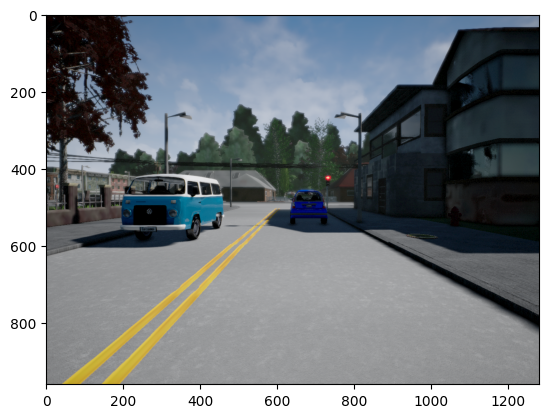

In [36]:
# Original Image
plt.imshow(dataset_handler.image)

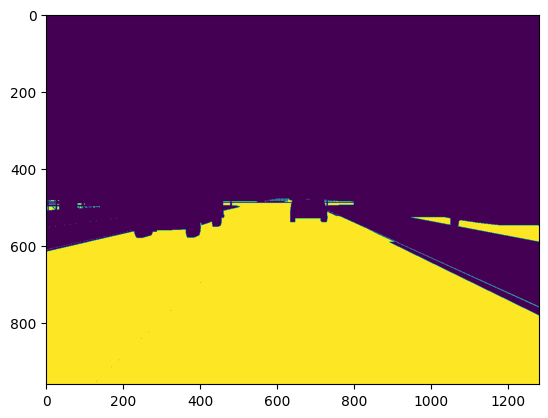

In [37]:
# Part I
dist = np.abs(dist_to_plane(p_final, x, y, z))

ground_mask = np.zeros(dist.shape)

ground_mask[dist < 0.1] = 1
ground_mask[dist > 0.1] = 0

plt.imshow(ground_mask)

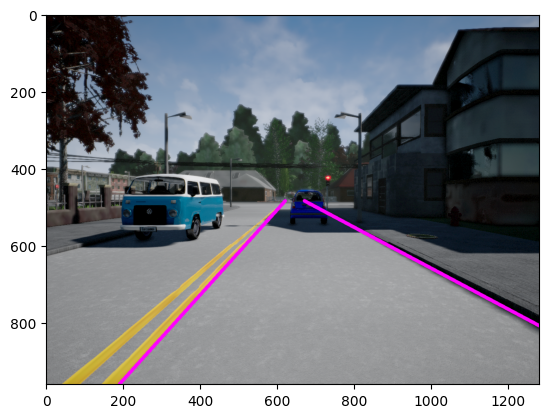

In [38]:
# Part II
plt.imshow(dataset_handler.vis_lanes(final_lanes))

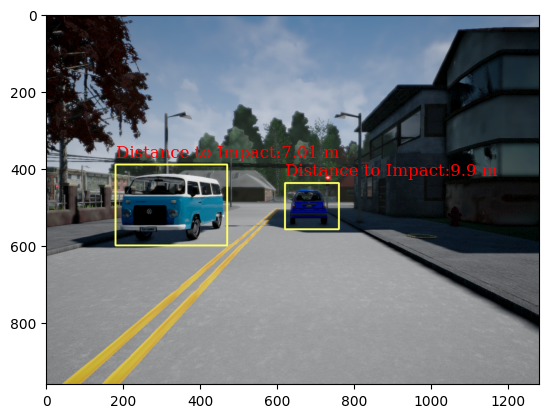

In [39]:
# Part III
font = {'family': 'serif','color': 'red','weight': 'normal','size': 12}

im_out = dataset_handler.vis_object_detection(filtered_detections)

for detection, min_distance in zip(filtered_detections, min_distances):
    bounding_box = np.asfarray(detection[1:5])
    plt.text(bounding_box[0], bounding_box[1] - 20, 'Distance to Impact:' + str(np.round(min_distance, 2)) + ' m', fontdict=font)

plt.imshow(im_out)

## Key Takeaways:

1. Semantic segmentation outputs are valuable for estimating drivable space.
2. Classical computer vision methods can effectively identify lane boundaries.
3. Semantic segmentation outputs also help filter unreliable object detection results.



